# **`Colorizing Grayscale Image using Deep Neural Networks.`**

In [1]:
#link to dataset
dataset_link = "https://www.kaggle.com/datasets/theblackmamba31/landscape-image-colorization"

In [2]:
from google.colab import drive
drive.mount('./gdrive',force_remount=True)

Mounted at ./gdrive


In [3]:
! pip install gdown
! rm -rf CMPE\ 258\ G2C data landscape\ Images
! mkdir data
import gdown

! gdown https://drive.google.com/drive/folders/1P8qo7TFPwiQYwuwa-Kabsm3sBa33CrZf?usp=sharing --folder

! unzip -q CMPE\ 258\ G2C/landscape\ Images.zip -d data
! mv ./data/landscape\ Images/* ./data
! rm -rf ./data/land* ./data/__MACOSX

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Retrieving folder list
Processing file 1GCzqt62E_4bPtqt8tN_aUc9H_ANCR6yl landscape Images.zip
Retrieving folder list completed
Building directory structure
Building directory structure completed
Downloading...
From: https://drive.google.com/uc?id=1GCzqt62E_4bPtqt8tN_aUc9H_ANCR6yl
To: /content/CMPE 258 G2C/landscape Images.zip
100% 207M/207M [00:06<00:00, 32.8MB/s]
Download completed


In [4]:
import warnings
warnings.filterwarnings('ignore', category=UserWarning, append=True)

In [5]:
import os
import cv2
import csv
import numpy as np
import pandas as pd

from math import ceil

import tensorflow as tf
from tensorflow import keras
from keras import Sequential
from tensorflow.keras.models import Model

import matplotlib.pyplot as plt


from sklearn.utils import shuffle
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split

from skimage.color import rgb2lab, lab2rgb

from tensorflow.keras.layers import Rescaling,RandomBrightness,RandomContrast,RandomZoom,RandomTranslation,Rescaling
from tensorflow.keras.layers import Input, Conv2D,MaxPooling2D, LeakyReLU, Flatten, Dense, Reshape, Conv2DTranspose, BatchNormalization, ReLU, Activation, Attention, Add


In [6]:
l1 = tf.keras.layers.RandomBrightness(factor=0.3)
l2 = tf.keras.layers.RandomContrast(factor=0.1)
l3 = tf.keras.layers.RandomZoom(.3, .3)
l4 = tf.keras.layers.RandomTranslation(.1,.1)

l6 = tf.keras.layers.RandomRotation(0.3)
l7 = tf.keras.layers.RandomFlip()

l8 = tf.keras.layers.GaussianNoise(0.1)

preprocessor = Sequential([
    l1,l3,l4,l6,l7,l8
])

In [7]:
img_names = os.listdir('./data/color')

train_img,test_img,_,_ = train_test_split(img_names,img_names,shuffle=True,test_size=0.1)
img_shape = (150,150,3)
class Crawler:
    def __init__(self, dir, img_names, img_shape = (128,128,3), preprocessor = preprocessor, preprocess = True):
        self.dir = dir
        self.imgs_nm = img_names
        self.img_shape = list(img_shape)
        self.pre = preprocessor
        self.pflag = preprocess

    def getNext(self):
        for img_p in self.imgs_nm:
            img_path_g = os.path.join(self.dir,'gray',img_p)
            img_gray = cv2.imread(img_path_g)
            img_gray = cv2.resize(img_gray,self.img_shape[:2])


            img_path_c = os.path.join(self.dir,'color',img_p)
            img_color = cv2.imread(img_path_c)
            img_color = cv2.resize(img_color,self.img_shape[:2])
            
              
            if self.pflag and np.random.randint(0,100) % 5 == 3:
                img_color = self.pre(np.asarray([img_color]))[0].numpy()

            img_gray = cv2.cvtColor(img_color,cv2.COLOR_RGB2GRAY)
            img_gray = cv2.cvtColor(img_gray,cv2.COLOR_GRAY2RGB)
            img_gray,img_color = img_gray/255.0,img_color/255.0
            img_gray,img_color = (img_gray*2)-1,(img_color*2)-1

            yield img_gray, img_color

In [8]:
img,img2 = next(iter(Crawler('./data',img_names,(150,150,3)).getNext()))

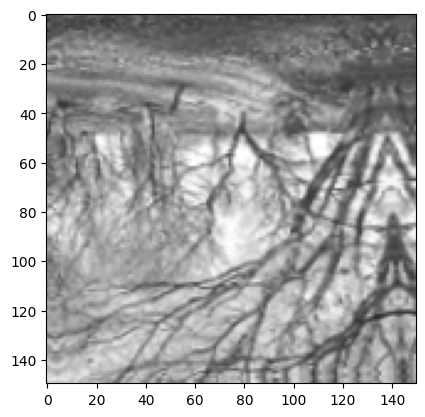

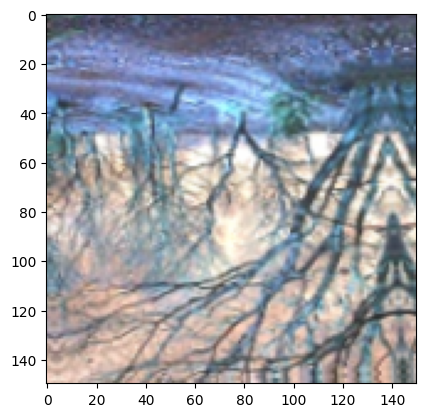

In [9]:
plt.imshow((img+1)/2)
plt.show()
plt.imshow((img2+1)/2)

In [10]:
class GAN:
    def __init__(self,img_shape,GOpt,DOpt,weight_path = "./gdrive/MyDrive/CMPE258FIN/model_weight", load_wei = False):
        self.img_shape = img_shape
        self.G = self.Generator()
        self.D = self.Discriminator()

        if load_wei:
            self.load_prev_model(weight_path)

        self.GOpt = GOpt
        self.DOpt = DOpt

        self.cross_entropy = tf.keras.losses.BinaryCrossentropy()
        self.MAE =tf.keras.losses.MeanAbsoluteError()

        self.metrics = [tf.keras.metrics.Mean(),tf.keras.metrics.Mean()]

    def save_weights(self,path):
        self.D.save_weights(os.path.join(path,'Dis'))
        self.G.save_weights(os.path.join(path,'Gen'))

    def load_prev_model(self, weight_path):
        self.D.load_weights(os.path.join(weight_path,'Dis'))
        self.G.load_weights(os.path.join(weight_path,'Gen'))
        

    
    @tf.function
    def GLoss(self,x_fake):
      return self.cross_entropy(tf.ones_like(self.D(x_fake)) - 0.1, self.D(x_fake))


    @tf.function
    def DLoss(self,x_real, x_fake):
      return self.cross_entropy(tf.ones_like(self.D(x_real)) - 0.1, self.D(x_real)) \
           + self.cross_entropy(tf.zeros_like(self.D(x_fake)) + 0.1, self.D(x_fake))
    

    def reset_metrics(self):
        self.metrics[0].reset_states()
        self.metrics[1].reset_states()


    @tf.function
    def trainer(self,x_pos,x_neg,log = False):
        # for _ in range(5):
        #     with tf.GradientTape() as GTape:
        #         x_fake = self.G(x_neg)
        #         G_loss_curr = self.GLoss(x_fake) + self.MAE(x_pos,x_fake)

        #     G_grad = GTape.gradient(G_loss_curr, self.G.trainable_variables) 
        #     self.GOpt.apply_gradients(zip(G_grad, self.G.trainable_variables))


        with tf.GradientTape() as GTape, tf.GradientTape() as DTape:  
            x_fake = self.G(x_neg) 

            G_loss_curr = self.GLoss(x_fake)  + self.MAE(x_pos,x_fake)
            D_loss_curr = self.DLoss(x_pos, x_fake)
        self.metrics[0].update_state(G_loss_curr)
        self.metrics[1].update_state(D_loss_curr)
        # Gradients
        G_grad = GTape.gradient(G_loss_curr, self.G.trainable_variables)
        D_grad = DTape.gradient(D_loss_curr, self.D.trainable_variables)
        # Apply gradients
        self.GOpt.apply_gradients(zip(G_grad, self.G.trainable_variables))
        self.DOpt.apply_gradients(zip(D_grad, self.D.trainable_variables))
    
    def residual_block(self,x, filters):
        input_data = x
        x = Conv2D(filters, kernel_size=3, strides=1, padding='same')(x)
        x = BatchNormalization()(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = Conv2D(filters, kernel_size=3, strides=1, padding='same')(x)
        x = BatchNormalization()(x)
        x = Add()([input_data, x])
        x = LeakyReLU(alpha=0.2)(x)
        return x

    def attention_layer(self,x, filters):
        input_data = x
        x = Conv2D(filters, kernel_size=1, strides=1, padding='same')(x)
        x = BatchNormalization()(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = Conv2D(filters, kernel_size=1, strides=1, padding='same')(x)
        x = BatchNormalization()(x)
        x = Attention()([input_data, x])
        x = LeakyReLU(alpha=0.2)(x)
        return x

    def Generator(self):
        input_layer = Input(shape=self.img_shape) 
        x = Conv2D(64, kernel_size=3, strides=1, padding='same')(input_layer)
        x = LeakyReLU(alpha=0.2)(x)
        
        x1 = self.residual_block(x, 64)
        x2 = self.residual_block(x1, 64)
        x3 = self.residual_block(x2, 64)

        x = self.attention_layer(x3, 64)
        

        x = Conv2D(128, kernel_size=3, strides=1, padding='same')(x)
        x = LeakyReLU(alpha=0.2)(x)


        x = Conv2D(3, kernel_size=3, strides=1, padding='same', activation='tanh')(x)
        return Model(input_layer,x)
    
    def colorizeImg(self,img):
        gen_img = self.G(img)
        img_li = []
        for img in gen_img: 
            img = img.numpy()
            img = cv2.resize(img,(150,150))
            img = (img + 1)/2
            img_li.append(img)
        return np.asarray(img_li)
    def Discriminator(self):
        input_layer = Input(shape=self.img_shape)
        x1 = Conv2D(64, kernel_size=3, strides=1)(input_layer)
        x1 = LeakyReLU(alpha=0.2)(x1)
        x1 = self.residual_block(x1, 64)

        x2 = x = Conv2D(64, kernel_size=3, strides=1)(input_layer)
        x2 = LeakyReLU(alpha=0.2)(x2)
        x2 = self.residual_block(x2, 64)
        
        x = Attention()([x1,x2])
        x = MaxPooling2D((3,3))(x)

        x = Conv2D(32, kernel_size=3, strides=1)(x)
        x = LeakyReLU(alpha=0.2)(x)

        x = self.attention_layer(x,32)

        x = Conv2D(32, kernel_size=3, strides=1)(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = MaxPooling2D((3,3))(x)

        x = Flatten()(x)
        x = Dense(256,activation='relu')(x)
        x = Dense(1024,activation='relu')(x)
        x = Dense(512,activation='relu')(x)
        x = Dense(3, activation='sigmoid')(x)
        return Model(input_layer, x)

In [11]:
wpath = "./gdrive/MyDrive/CMPE258FIN/model_weight"

In [12]:
batch_size = 16

train_gen = Crawler('./data',train_img,img_shape)
test_gen = Crawler('./data',test_img,img_shape,preprocess=False)

train_data = tf.data.Dataset.from_generator(train_gen.getNext,output_signature = ( tf.TensorSpec(img_shape,dtype=tf.float64),tf.TensorSpec(img_shape,dtype=tf.float64) ))
test_data = tf.data.Dataset.from_generator(test_gen.getNext,output_signature = ( tf.TensorSpec(img_shape,dtype=tf.float64),tf.TensorSpec(img_shape,dtype=tf.float64) ))

train_data = train_data.batch(batch_size).prefetch(tf.data.AUTOTUNE)
test_data = test_data.batch(batch_size).prefetch(tf.data.AUTOTUNE)


In [13]:
learning_rate_fn_1 = tf.keras.optimizers.schedules.PolynomialDecay(1e-03,128*8*100*10000, 1e-012, power=0.95)
learning_rate_fn_2 = tf.keras.optimizers.schedules.PolynomialDecay(1e-05,128*9*100*10000, 1e-013, power=0.95)

# Optimizers
G_opt = tf.optimizers.Adam(learning_rate=learning_rate_fn_1,beta_1=0.5,beta_2=0.95, clipnorm=1.0, epsilon=1e-09,amsgrad=True)
D_opt = tf.optimizers.Adam(learning_rate=learning_rate_fn_2,beta_1=0.5,beta_2=0.95, clipnorm=1.0, epsilon=1e-09,amsgrad=True)

gan_model = GAN(img_shape,G_opt,D_opt,weight_path=wpath,load_wei=True)

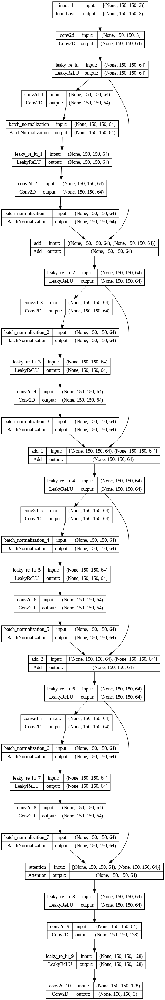

In [20]:
tf.keras.utils.plot_model(gan_model.G,show_shapes = True)

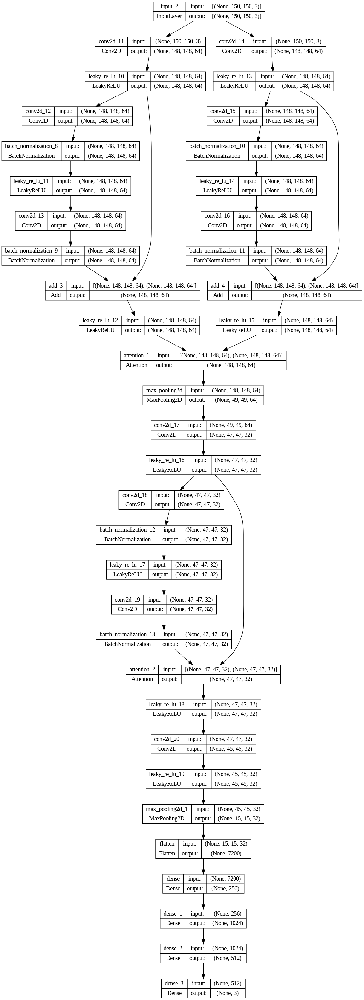

In [21]:
tf.keras.utils.plot_model(gan_model.D,show_shapes = True)

In [18]:
gan_model.D.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_11 (Conv2D)             (None, 148, 148, 64  1792        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_14 (Conv2D)             (None, 148, 148, 64  1792        ['input_2[0][0]']                
                                )                                                           

In [19]:
gan_model.G.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 150, 150, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 150, 150, 64  0           ['conv2d[0][0]']                 
                                )                                                             

Logger (Batch Number,Epoch): 1 1
Metrics
tf.Tensor(0.5, shape=(), dtype=float32) tf.Tensor(0.5, shape=(), dtype=float32)
GenLoss: 0.780158937, DisLoss: 1.386294365


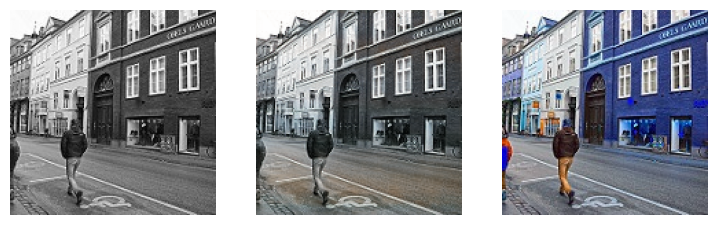

Logger (Batch Number,Epoch): 51 1
Metrics
tf.Tensor(0.5, shape=(), dtype=float32) tf.Tensor(0.5, shape=(), dtype=float32)
GenLoss: 0.779817462, DisLoss: 1.386294842


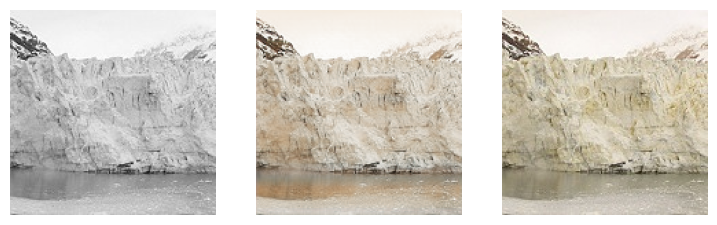

Logger (Batch Number,Epoch): 101 1
Metrics
tf.Tensor(0.5, shape=(), dtype=float32) tf.Tensor(0.5, shape=(), dtype=float32)
GenLoss: 0.783581018, DisLoss: 1.386293173


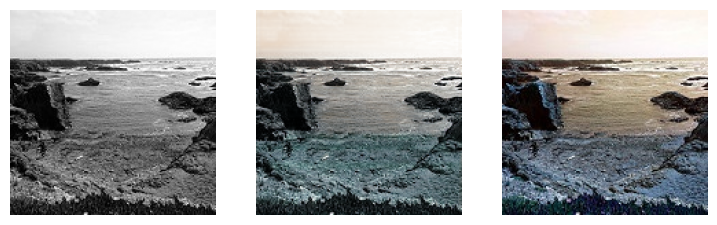

Logger (Batch Number,Epoch): 151 1
Metrics
tf.Tensor(0.5, shape=(), dtype=float32) tf.Tensor(0.5, shape=(), dtype=float32)
GenLoss: 0.783068717, DisLoss: 1.386292577


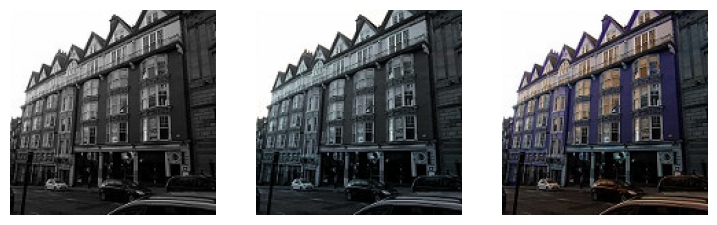

Logger (Batch Number,Epoch): 201 1
Metrics
tf.Tensor(0.5, shape=(), dtype=float32) tf.Tensor(0.5, shape=(), dtype=float32)
GenLoss: 0.783208966, DisLoss: 1.386292458


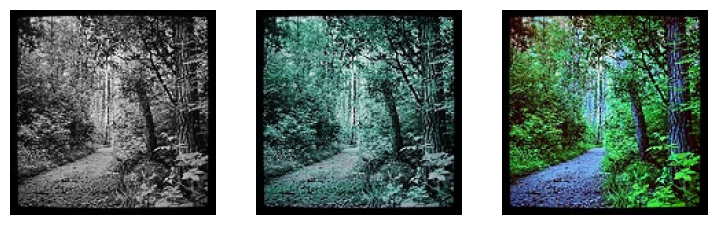

Logger (Batch Number,Epoch): 251 1
Metrics
tf.Tensor(0.5, shape=(), dtype=float32) tf.Tensor(0.5, shape=(), dtype=float32)
GenLoss: 0.783331931, DisLoss: 1.386292219


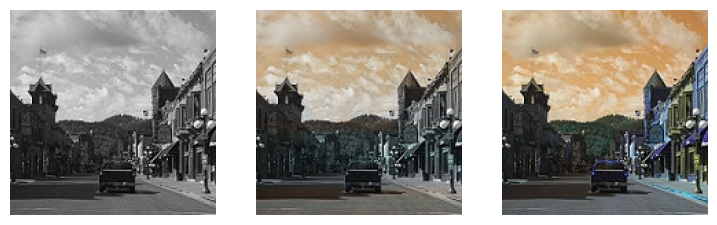

Logger (Batch Number,Epoch): 301 1
Metrics
tf.Tensor(0.5, shape=(), dtype=float32) tf.Tensor(0.5, shape=(), dtype=float32)
GenLoss: 0.783483028, DisLoss: 1.386292100


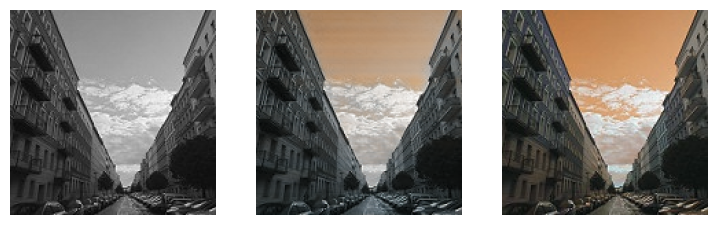

Logger (Batch Number,Epoch): 351 1
Metrics
tf.Tensor(0.5, shape=(), dtype=float32) tf.Tensor(0.5, shape=(), dtype=float32)
GenLoss: 0.783624113, DisLoss: 1.386291981


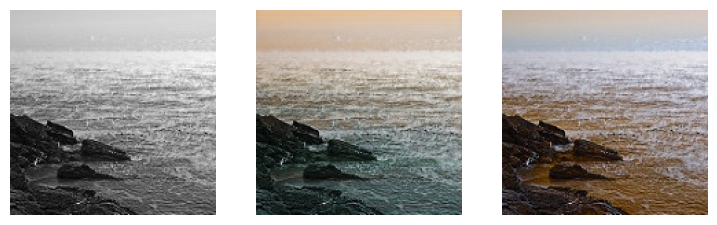

Logger (Batch Number,Epoch): 401 1
Metrics
tf.Tensor(0.5, shape=(), dtype=float32) tf.Tensor(0.5, shape=(), dtype=float32)
GenLoss: 0.783751070, DisLoss: 1.386291981


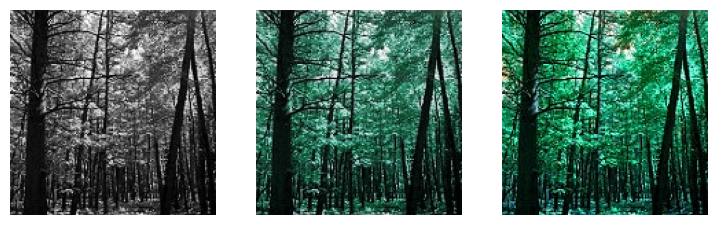

In [ ]:
def train_model(model,epochs,train_data,save_data = True):
    imgs_iter = []
    metrics = [[],[],[],[]]
    for epoch in range(epochs):
        for bnum,rdata in enumerate(train_data):
            gray_imgs,clrs_imgs = rdata
            
            model.trainer(clrs_imgs,gray_imgs,bnum%1000==0)
            if bnum % 50 == 0:
                print('Logger (Batch Number,Epoch):',bnum+1,epoch+1)
                # Plot generated images
                img_gen = model.colorizeImg(gray_imgs)
                print("Metrics")
                print(tf.reduce_mean(model.D(clrs_imgs)),tf.reduce_mean(model.D(model.G(gray_imgs))))
                print("GenLoss: {:.9f}, DisLoss: {:.9f}".format(model.metrics[0].result(),model.metrics[1].result()))
                
                metrics[0].append(model.metrics[0].result())
                metrics[1].append(model.metrics[1].result())


                metrics[2].append(tf.reduce_mean(model.D(clrs_imgs)))
                metrics[3].append(tf.reduce_mean(model.D(model.G(gray_imgs))))
                
                plt.figure(figsize=(9,6))
                
                plt.subplot(1,3,1)
                gimg = gray_imgs[0,:,:,:].numpy()
                gimg = (gimg - gimg.min())/(gimg.max() - gimg.min())
                plt.imshow(gimg)
                plt.axis('off')

                plt.subplot(1,3,2)
                img = img_gen[0,:,:,:]
                #img = ((img - tf.reduce_min(img)) / (tf.reduce_max(img) - tf.reduce_min(img)))
                plt.imshow(img)
                plt.axis('off')

                if bnum == 0:
                    imgs_iter.append(img)

                plt.subplot(1,3,3)
                img = clrs_imgs[0,:,:,:]

                img = img.numpy()
                img = (img+1)/2
                #img = (img - img.min())/(img.max() - img.min())
                
                plt.imshow(img)
                plt.axis('off')

                plt.show()
                

        model.reset_metrics()
        if save_data:
            gan_model.save_weights(wpath)
    return imgs_iter,metrics
hist = train_model(gan_model,1,train_data,True)

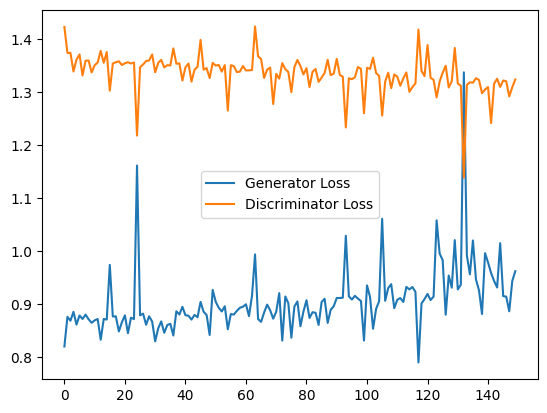

In [ ]:
imgs_hist,(gen_loss_hist,dis_loss_hist,acc_real,acc_gen) = hist
plt.plot(gen_loss_hist,label = "Generator Loss")
plt.plot(dis_loss_hist, label = "Discriminator Loss")
plt.legend()
plt.show()

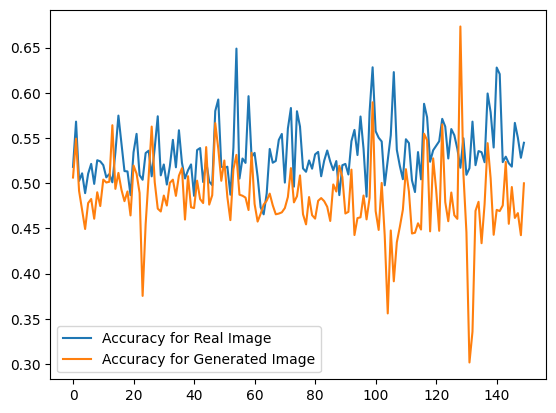

In [ ]:
plt.plot(acc_real,label="Accuracy for Real Image")
plt.plot(acc_gen,label = "Accuracy for Generated Image")
plt.legend()
plt.show()

In [ ]:
metrics = [tf.keras.metrics.Mean(),tf.keras.metrics.Mean(),tf.keras.metrics.Mean()]
for img_gry,img_col in test_data:
    img_gen = gan_model.G(img_gry)
    D_loss_curr = gan_model.DLoss(img_col, img_gen)
    metrics[0].update_state(gan_model.GLoss(img_gen))
    metrics[1].update_state(gan_model.MAE(img_col,img_gen))
    metrics[2].update_state(D_loss_curr)

In [ ]:
print("Test Loss:  Generator Cross Entropy Loss:",metrics[0].result().numpy(),"Generator Mean Abs Err:",metrics[1].result().numpy(),"Discriminator:",metrics[2].result().numpy())

Test Loss:  Generator Cross Entropy Loss: 0.76781535 Generator Mean Abs Err: 0.15612416 Discriminator: 1.3931202


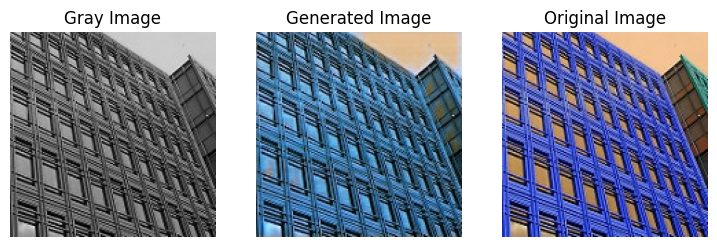

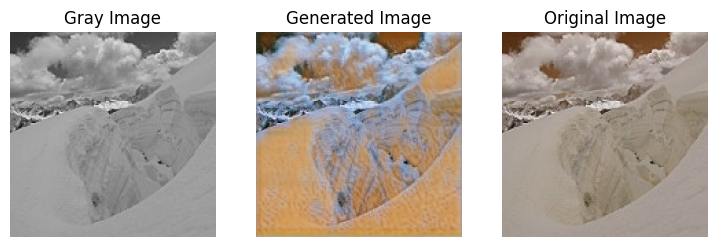

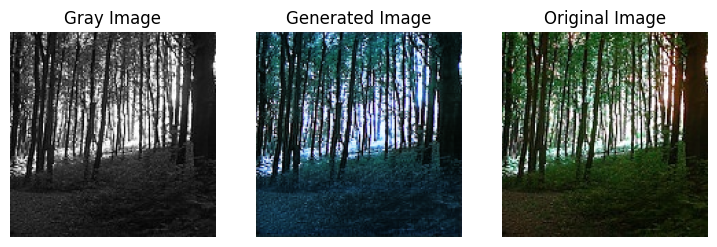

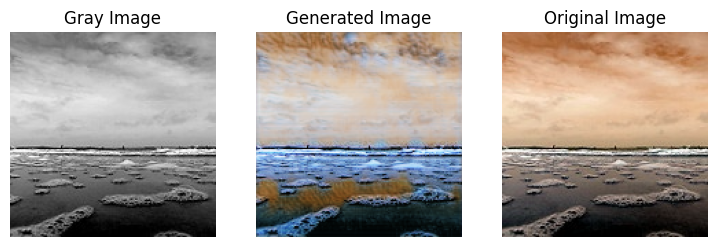

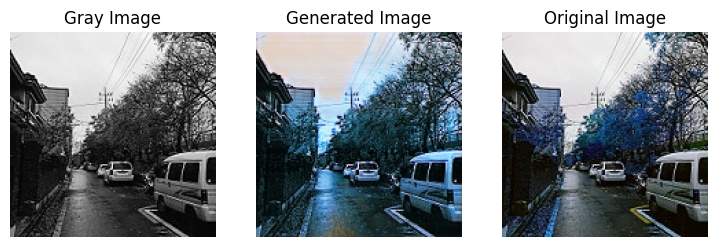

...

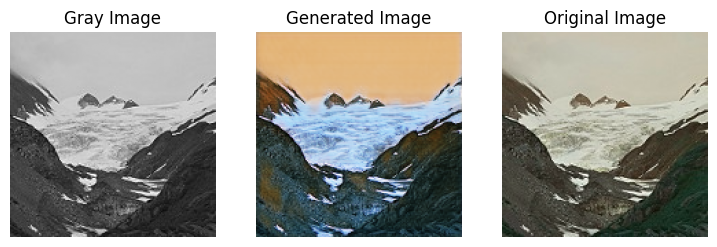

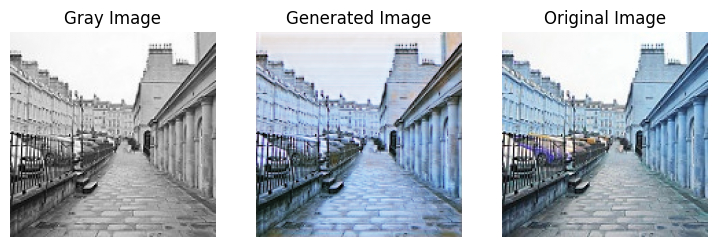

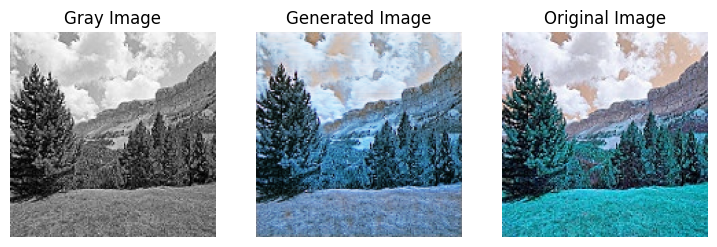

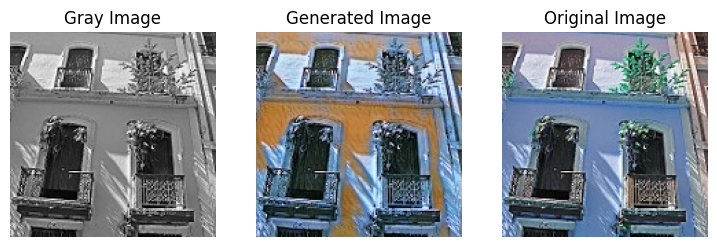

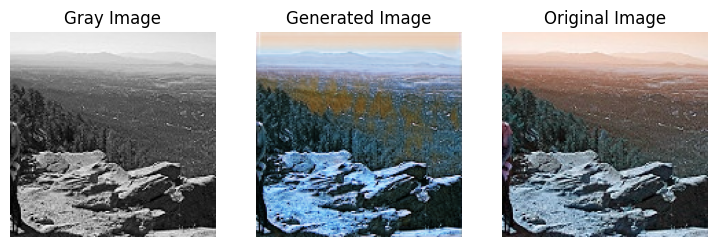

In [ ]:
for img_gry,img_col in test_data.take(1):
    img_gen = gan_model.colorizeImg(img_gry)

    for img_in,img_g,img_org in zip(img_gry,img_gen,img_col):
        plt.figure(figsize=(9,6))
        plt.subplot(1,3,1)
        plt.imshow((img_in+1)/2)
        plt.title("Gray Image")
        plt.axis('off')

        plt.subplot(1,3,2)
        plt.imshow(img_g)
        plt.title("Generated Image")
        plt.axis('off')

        plt.subplot(1,3,3)
        plt.imshow((img_org+1)/2)
        plt.title("Original Image")
        plt.axis('off')
        plt.show()